**Problem Statement**:

As part of our capstone project, we have decided to address a real-life problem of IT ticket assignment. 

For any IT function to ensure smooth business operations, there should be minimal to zero impact / disruptions to users or services. However, any unplanned interruption in service affects end users and overall business. In real life, it has been observed that there are number of tickets gets created and assigned to the group looking at some “words” in the problem statement and may end up with a wrong IT group to tackle the problem. In such cases, it is evident that ticket(s) go through multiple rounds of back and forth and ultimately creates dissatisfaction among users and increases cost of IT group handling ticket. 

The manual assignment of tickets might have below disadvantages:
    • Delay in assignment of ticket to correct group
    • Misinterpretation of issue and hence wrong assignment of ticket
    • Delay in resolving an issue with one ticket will start impacting other tickets in queue

**Objective**:

To avoid this problem of ticket getting assigned to a “wrong” group due to  wrong interpretation or any delay, we have undertaken a project for Automated Ticket Assignment, wherein we plan create a model which would apply Natural Language Processing algorithms on the available datapoints from end user and would try to assign the ticket to the correct group. 

From the given problem description, we could see that the existing system is able to assign 75% of the tickets correctly. 

So, our objective here is to build an AI-based classifier model to assign the tickets to right functional groups by analyzing the given description with an accuracy of at least 85%.

# **EDA**

In [1]:
# Mount Google Drive
from google.colab import drive # import drive from google colab
ROOT = "/content/drive"     # default location for the drive
drive.mount(ROOT)           # we mount the google drive at /content/drive

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
# Go to the project folder
import os
MY_GOOGLE_DRIVE_PATH ='My Drive/AIML/AUTOMATIC_TICKET_ASSIGNMENT'
PROJECT_PATH = os.path.join(ROOT, MY_GOOGLE_DRIVE_PATH)
%cd {PROJECT_PATH}   

/content/drive/My Drive/AIML/AUTOMATIC_TICKET_ASSIGNMENT


In [3]:
# Import basic libs for EDA
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## Loading data

In [4]:
#Load Data
data = pd.read_excel('input_data.xlsx')
data.head()

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [5]:
# Get the shape of data
data.shape

(8500, 4)

In [6]:
# Print Info about Data
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 4 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Short description  8492 non-null   object
 1   Description        8499 non-null   object
 2   Caller             8500 non-null   object
 3   Assignment group   8500 non-null   object
dtypes: object(4)
memory usage: 265.8+ KB


## Check for Missing fields

In [7]:
data.isna().sum()

Short description    8
Description          1
Caller               0
Assignment group     0
dtype: int64

In [8]:
#Check all the null values in Short description
data[data['Short description'].isna()==True]

,Short description,Description,Caller,Assignment group
2604,NaN,\r\n\r\nreceived from: ohdrnswl.rezuibdt@gmail...,ohdrnswl rezuibdt,GRP_34
3383,NaN,\r\n-connected to the user system using teamvi...,qftpazns fxpnytmk,GRP_0
3906,NaN,-user unable tologin to vpn.\r\n-connected to...,awpcmsey ctdiuqwe,GRP_0
3910,NaN,-user unable tologin to vpn.\r\n-connected to...,rhwsmefo tvphyura,GRP_0
3915,NaN,-user unable tologin to vpn.\r\n-connected to...,hxripljo efzounig,GRP_0
3921,NaN,-user unable tologin to vpn.\r\n-connected to...,cziadygo veiosxby,GRP_0
3924,NaN,name:wvqgbdhm fwchqjor\nlanguage:\nbrowser:mic...,wvqgbdhm fwchqjor,GRP_0
4341,NaN,\r\n\r\nreceived from: eqmuniov.ehxkcbgj@gmail...,eqmuniov ehxkcbgj,GRP_0


In [9]:
#Check all the null values in Description
data[data['Description'].isna()==True]

,Short description,Description,Caller,Assignment group
4395,i am locked out of skype,NaN,viyglzfo ajtfzpkb,GRP_0


As we already have only 8500 ticket to train our mode. We do not want to drop any column. So we are going to fill our null values.

In [10]:
# Copy Short to Long and vice versa For Null Values
data['Short description'] = data['Short description'].fillna(data['Description'])
data['Description'] = data['Description'].fillna(data['Short description'])

In [11]:
# Lets again check for null
data.isna().sum()

Short description    0
Description          0
Caller               0
Assignment group     0
dtype: int64

By checking the data we already know that there are lots of column in which description contains everything which is present in short description. So let's check those.

In [12]:
# Check How many short des are present in Desc
combine_df = data.copy() # Create a New df
combine_df['similar'] = combine_df.apply(lambda col : col['Short description'] in col ['Description'],axis =1)
print(combine_df.groupby('similar').count())
print('Before doing any cleaning we can see that there are 4148 columns in which short description is present in long description')

         Short description  Description  Caller  Assignment group
similar                                                          
False                 4352         4352    4352              4352
True                  4148         4148    4148              4148
Before doing any cleaning we can see that there are 4148 columns in which short description is present in long description


In [13]:
df1 = combine_df[combine_df['similar'] ==  False]
df1.head(10)

,Short description,Description,Caller,Assignment group,similar
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0,False
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0,False
6,event: critical:HostName_221.company.com the v...,event: critical:HostName_221.company.com the v...,jyoqwxhz clhxsoqy,GRP_1,False
21,vpn issue,\r\n\r\nreceived from: ugephfta.hrbqkvij@gmail...,ugephfta hrbqkvij,GRP_0,False
24,vpn not working,\n\nreceived from: dceoufyz.saufqkmd@gmail.com...,dceoufyz saufqkmd,GRP_0,False
31,reset users,hi\n\nplease reset users password\n\nclient id...,qcehailo wqynckxg,GRP_0,False
32,duplication of network address.,\n\nreceived from: kxsceyzo.naokumlb@gmail.com...,kxsceyzo naokumlb,GRP_4,False
37,unable to resolve ticket_no assigned to self,the status button is dierppearing after a few ...,shloyakw jztsxdln,GRP_0,False
38,installing engineering tool,need to install engineering tool on the pc,qcxivzag vyucbagx,GRP_0,False
43,please reroute jobs on printer01 to printer02 ...,\n\nreceived from: yisohglr.uvteflgb@gmail.com...,yisohglr uvteflgb,GRP_5,False


We can see that there is almost 50% short des data is same in long des. But, we can also see that remaning data is also have smililarity. So before combinnig the data first clean both the colum.

## Cleaning Process...

In [14]:
#Import usefull libs
import nltk
import re
from nltk.stem import WordNetLemmatizer
from nltk.corpus import wordnet
from nltk.corpus import stopwords

In [15]:
## NLTK Downloads
nltk.download('stopwords')
stop = set(stopwords.words('english')) 
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [16]:
#function to convert nltk tag to wordnet tag
def nltk_tag_to_wordnet_tag(nltk_tag):
    if nltk_tag.startswith('J'):
        return wordnet.ADJ
    elif nltk_tag.startswith('V'):
        return wordnet.VERB
    elif nltk_tag.startswith('N'):
        return wordnet.NOUN
    elif nltk_tag.startswith('R'):
        return wordnet.ADV
    else:          
        return None

In [17]:
def lemmatize_sentence(sentence):
    #tokenize the sentence and find the POS tag for each token
    nltk_tagged = nltk.pos_tag(nltk.word_tokenize(sentence))  
    #tuple of (token, wordnet_tag)
    wordnet_tagged = map(lambda x: (x[0], nltk_tag_to_wordnet_tag(x[1])), nltk_tagged)
    lemmatized_sentence = []
    for word, tag in wordnet_tagged:
        if tag is None:
            #if there is no available tag, append the token as is
            lemmatized_sentence.append(word)
        else:        
            #else use the tag to lemmatize the token
            lemmatized_sentence.append(lemmatizer.lemmatize(word, tag))
    return " ".join(lemmatized_sentence)

In [18]:
def Clean_Sentense (col):
  temp =[]
  for sentence in col:
      sentence = sentence.lower()
      #sentence = sentence.str.replace('\d+', '')
      cleanr = re.compile('<.*?>')
      sentence = re.sub(cleanr, ' ', sentence)        #Removing HTML tags
      sentence = re.sub(r'\S+@\S+', 'EmailId', sentence)
      sentence = re.sub(r'\'', '', sentence, re.I|re.A)
      sentence = re.sub(r'[0-9]', '', sentence, re.I|re.A)
      #print ("Sentence1.5 = ",sentence)
      sentence = re.sub(r'[^a-zA-Z0-9\s]', ' ', sentence)
      #print ("Sentence2 = ",sentence)
      sentence = sentence.lower()
      sentence = re.sub(r"received from:",' ',sentence)
      sentence = re.sub(r"from:",' ',sentence)
      sentence = re.sub(r"to:",' ',sentence)
      sentence = re.sub(r"subject:",' ',sentence)
      sentence = re.sub(r"sent:",' ',sentence)
      sentence = re.sub(r"ic:",' ',sentence)
      sentence = re.sub(r"cc:",' ',sentence)
      sentence = re.sub(r"bcc:",' ',sentence)
      sentence = re.sub(r'com ', ' ', sentence, re.I|re.A)
      sentence = re.sub(r'hello ', ' ', sentence, re.I|re.A)
      sentence = re.sub(r'receive', ' ', sentence, re.I|re.A)
      sentence = re.sub(r'emailid', ' ', sentence, re.I|re.A)
      l_sentence = lemmatize_sentence(sentence)

      words = l_sentence.split() 
      noise_free_words = [word for word in words if word not in stopwords.words('english')] 
      noise_free_text = " ".join(noise_free_words)  
      temp.append(noise_free_text)
  return temp

In [19]:
lemmatizer = WordNetLemmatizer() # Define WordNetLemmatizer

In [20]:
# Create new col Clena_Desc
combine_df['Clean_Desc'] = Clean_Sentense(combine_df['Description'])
combine_df['Clean_Desc']

0       verify user detail employee manager name check...
1       team meeting skype meeting etc appear outlook ...
2                                         hi log vpn best
3                              unable access hr tool page
4                                             skype error
                              ...                        
8495    good afternoon receive email send zz mail plea...
8496                             telephony software issue
8497          vip window password reset tifpdchb pedxruyf
8498    unable access machine utility finish drawer ad...
8499    mehreren pc lassen sich verschiedene prgramdnt...
Name: Clean_Desc, Length: 8500, dtype: object

In [21]:
# Create new col Clean_Short_Desc
combine_df['Clean_Short_Desc'] = Clean_Sentense(combine_df['Short description'])
combine_df['Clean_Short_Desc']

0                                             login issue
1                                                 outlook
2                                            cant log vpn
3                              unable access hr tool page
4                                             skype error
                              ...                        
8495                                   email come zz mail
8496                             telephony software issue
8497          vip window password reset tifpdchb pedxruyf
8498                            machine n est funcionando
8499    mehreren pc lassen sich verschiedene prgramdnt...
Name: Clean_Short_Desc, Length: 8500, dtype: object

In [22]:
# As our text is clean now. So let's again check for Similarity in Clean_Desc and Clean_Short_Desc then after we can combine both for our feature.
combine_df['similar'] = combine_df.apply(lambda col : col['Clean_Short_Desc'] in col ['Clean_Desc'],axis =1)
print(combine_df.groupby('similar').count())
print('Now after cleaning we can see similar column is increased from 4148 to 5283')

         Short description  Description  ...  Clean_Desc  Clean_Short_Desc
similar                                  ...                              
False                 3217         3217  ...        3217              3217
True                  5283         5283  ...        5283              5283

[2 rows x 6 columns]
Now after cleaning we can see similar column is increased from 4148 to 5283


Now we can see that there are other language present, So lets first find out those and translate it to english.

## Language Translation

In [23]:
#Install google translator by pip if not installed
!pip install -q googletrans
from googletrans import Translator

     |████████████████████████████████| 61kB 5.9MB/s 
     |████████████████████████████████| 51kB 8.3MB/s 
     |████████████████████████████████| 942kB 16.1MB/s 
     |████████████████████████████████| 71kB 10.2MB/s 
     |████████████████████████████████| 61kB 9.3MB/s 
     |████████████████████████████████| 102kB 10.3MB/s 


In [24]:
def translateIfRequired(x):
    translator = Translator()
    if translator.detect(x).lang != 'en':
        translatedText = translator.translate(x).text
    else:
        translatedText = x
    return translatedText

In [25]:
for i in combine_df.index:
    combine_df['Clean_Short_Desc'][i] = translateIfRequired(combine_df['Clean_Short_Desc'][i])
    combine_df['Clean_Desc'][i] = translateIfRequired(combine_df['Clean_Desc'][i])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [26]:
print(combine_df['Clean_Desc'][265]) # transalted sentence

hello netweaver no longer works or I can no longer open it, best regards


Lets combine the clean_desc and clean_short_desc

## Combine Description

In [27]:
# Combine cleaned shot desc and Desc. Only add those words from short desc which is not in Desc.
combined_sentence = []
for i in combine_df.index:
    temp_sent = combine_df['Clean_Desc'][i]
    if (combine_df['similar'][i] == True):
      combined_sentence.append(temp_sent)
    else:
      words = combine_df['Clean_Short_Desc'][i].split() 
      new_words = [word for word in words if word not in temp_sent]
      new_text = " ".join(new_words)
      new_text +=" " + temp_sent
      combined_sentence.append(new_text)
combine_df['combined_sentence'] = combined_sentence;

In [28]:
# check if any row has empty data
combine_df[combine_df['combined_sentence'] == ""].head()

,Short description,Description,Caller,Assignment group,similar,Clean_Desc,Clean_Short_Desc,combined_sentence
1081,ç”¨å‹è½¯ä»¶é—®é¢˜,"æ‰“å¼€å·²å…³é—­çš„é”€å”®è®¢å•æ—¶ï¼Œæ˜¾ç¤º""ä¸...",bwstnmjh yqumwrsk,GRP_48,True,,,
1178,ç”µè¯æœºæ²¡æœ‰å£°éŸ³,ç”µè¯æœºæ²¡æœ‰å£°éŸ³,cyjlqdwm kywiuosn,GRP_30,True,,,
1452,è€ƒå‹¤ç³»ç»Ÿè¿›ä¸åŽ»è¯·å¤„ç†è°¢è°¢ï¼,è€ƒå‹¤ç³»ç»Ÿè¿›ä¸åŽ»è¯·å¤„ç†è°¢è°¢ï¼,spgdcvhb ocagnpmj,GRP_30,True,,,
1700,è´¦æˆ·è¢«é”å®š,ç”¨æˆ·å¿˜è®°å¯†ç ï¼Œå¯¼è‡´è´¦æˆ·é”å®š,neovalui kabpfvic,GRP_48,True,,,
1701,è¾“å…¥ç”¨æˆ·åå’Œå¯†ç åŽæ˜¾ç¤ºå‡ºé”™,ç™»å½•æ—¶è¾“å…¥ç”¨æˆ·åå’Œå¯†ç åŽï¼Œæ˜¾ç¤ºç...,ofiglcaq hvcqtzel,GRP_48,True,,,


In [29]:
# Replace all the empty value to null so we can drop those
combine_df['combined_sentence'].replace('', np.nan, inplace=True)

In [30]:
# drop empty rows
combine_df.dropna(inplace=True)
combine_df.shape

(8464, 8)

In [31]:
#Lets drop short description, Description, Clean_Desc and clean_short_desc as we combine the text and stored in combined_sentence
#Also drop 'Caller' as it a unique called id which is of no use for our modeling.
#Make a new df named clean_df with feature and target column
clean_df = combine_df[['combined_sentence','Assignment group']]
clean_df.head() 

,combined_sentence,Assignment group
0,verify user detail employee manager name check...,GRP_0
1,team meeting skype meeting etc appear outlook ...,GRP_0
2,cant hi log vpn best,GRP_0
3,unable access hr tool page,GRP_0
4,skype error,GRP_0


In [ ]:
# Save the clean data file so we do not need to go through all the above process again for future use
# clean_df.to_csv("clean_df.csv",index= False,encoding="utf-8") 
# clean_df = pd.read_csv("clean_df.csv",encoding="utf-8")

## Expolre Target Column

In [32]:
# Check the target colum counts
print(clean_df.groupby('Assignment group')['Assignment group'].count().sort_values(ascending=False))
print('There are 74 unique columns in our target')

Assignment group
GRP_0     3975
GRP_8      661
GRP_24     289
GRP_12     257
GRP_9      252
          ... 
GRP_67       1
GRP_61       1
GRP_73       1
GRP_35       1
GRP_70       1
Name: Assignment group, Length: 74, dtype: int64
There are 74 unique columns in our target


In [33]:
def PlotTargetCol(df):
  #Lets get the visual representation 
  descending_order = df['Assignment group'].value_counts().sort_values(ascending=False).index
  plt.subplots(figsize=(22,5))
  ax=sns.countplot(x='Assignment group', data=df)
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
  plt.tight_layout()
  plt.show()

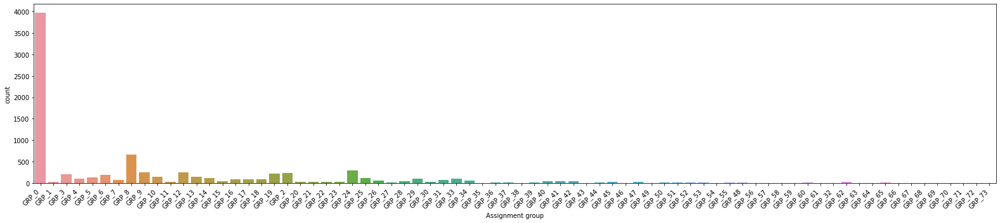

In [34]:
PlotTargetCol(clean_df)

Length of final description

In [35]:
clean_df['len_final_Description'] = clean_df['combined_sentence'].apply(lambda x: len(x.split(" ")))

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [36]:
print(f"Max Len : {clean_df['len_final_Description'].max()}")
print(f"Min Len : {clean_df['len_final_Description'].min()}")

Max Len : 1731
Min Len : 1


As we clearly see we need to do some data augmentation as data is too much imbalanced

## Data Augmentation

In [ ]:
!pip install transformers
!pip install pytorch_pretrained_bert pytorch-nlp
!pip install python-dotenv
!pip install nlpaug==0.0.16

In [38]:
import nlpaug.augmenter.word as naw
from nlpaug.util import Action
from pytorch_pretrained_bert import BertTokenizer
from transformers import XLNetTokenizer, XLNetModel, GPT2Model, GPT2PreTrainedModel, GPT2Tokenizer

from sklearn.utils import resample

We augment the data to the groups which has less than 60 ticket

In [39]:
data_augment = clean_df.copy()
data_grouped = clean_df.groupby(['Assignment group'])
unique_group = clean_df['Assignment group'].unique()

smaller_group = []
for group in unique_group:
  count = data_augment[data_augment['Assignment group']==group].shape[0]
  if count<60:
    smaller_group.append(group)
print(len(smaller_group))

51


In [ ]:
augmented_data = data_augment[['combined_sentence','Assignment group']]
for group in smaller_group:
  index = augmented_data.shape[0]
  for item in data_augment[data_augment['Assignment group']==group].index:
    # #Augment case 1
    aug = naw.ContextualWordEmbsAug(model_path= 'bert-base-uncased', action="insert")
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1
    #Augment case 2
    aug = naw.ContextualWordEmbsAug(model_path='bert-base-uncased', action="substitute")
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1
    #Augment case 3
    aug = naw.ContextualWordEmbsAug(model_path='distilbert-base-uncased', action="substitute")
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1
    #Augment case 4
    aug = naw.ContextualWordEmbsAug(model_path='roberta-base', action="substitute")
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1
    #Augment case 5
    aug = naw.SynonymAug(aug_src='wordnet')
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1
    #Augment case 6
    aug = naw.RandomWordAug(action="swap",aug_min=3)
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1
    #Augment case 7
    aug = naw.RandomWordAug(aug_min=2)
    augmented_text = aug.augment(augmented_data['combined_sentence'][item])
    augmented_data.loc[index] = [augmented_text,group]
    index+=1

In [41]:
# Augmented data shape
augmented_data.shape

(12552, 2)

In [ ]:
# Save clean data file so we do not need to do again all the cleaning process.
# augmented_data.to_csv("augmented_data.csv",index= False,encoding="utf-8") 
# augmented_data = pd.read_csv("augmented_data.csv",encoding="utf-8") 

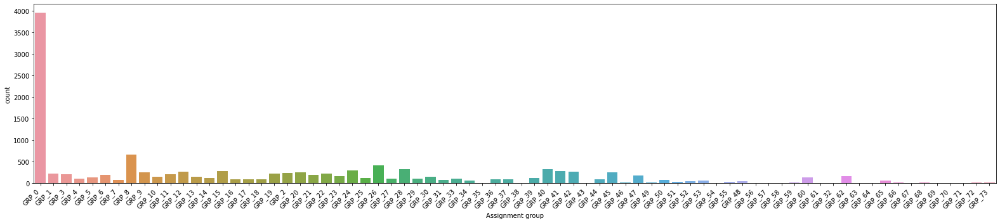

In [42]:
PlotTargetCol(augmented_data)

After augmentation we can see that still there are lots of imbalnce so we need to resample the data

## Resampling

In [43]:
#resampling
resampled_DF = augmented_data[0:0]
samples = 661 #Apart from GRP_0 we see 661 is highest number of groups hold by GRP_8
overall_groups = augmented_data['Assignment group'].unique()
for group in overall_groups:
    resampleGRP = augmented_data[augmented_data['Assignment group'] == group]
    resampled = resample(resampleGRP, replace=True, n_samples=int(samples), random_state=123)
    resampled_DF = resampled_DF.append(resampled)

In [44]:
# shape after resampling
resampled_DF.shape

(48914, 2)

In [ ]:
# Save clean data file so we do not need to do again all the cleaning process.
# resampled_DF.to_csv("resampled_DF.csv",index= False,encoding="utf-8") 
# resampled_DF = pd.read_csv("resampled_DF.csv",encoding="utf-8")

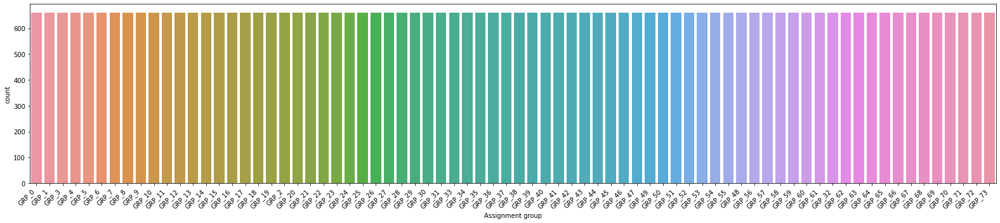

In [45]:
PlotTargetCol(resampled_DF)

Now our data is balanced so lets do some visualization.

# **Visualization**

## WordCloud visualization

In [46]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import matplotlib.pyplot as plt
% matplotlib inline

stopwords = set(STOPWORDS)
## function to create Word Cloud
def show_wordcloud(data, title):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=200,
        max_font_size=40, 
        scale=3,
        random_state=1
    ).generate(str(data))

    fig = plt.figure(1, figsize=(15, 12))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

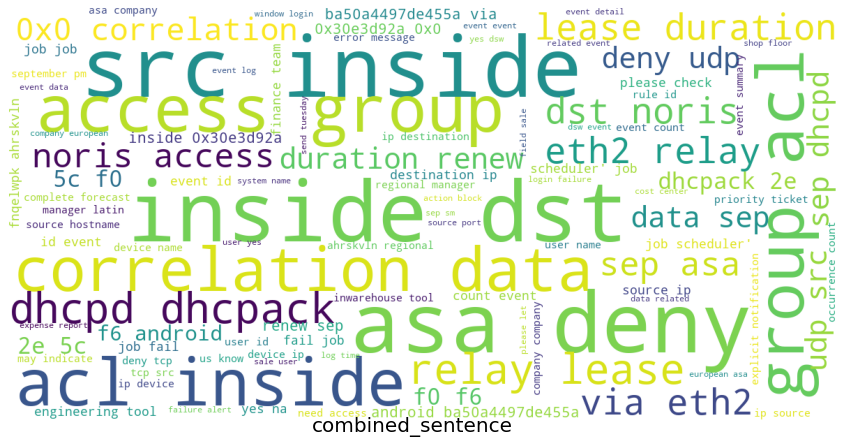

In [47]:
# Word Cloud for full data
text_Str = resampled_DF['combined_sentence'].tolist()
show_wordcloud(text_Str,"combined_sentence")

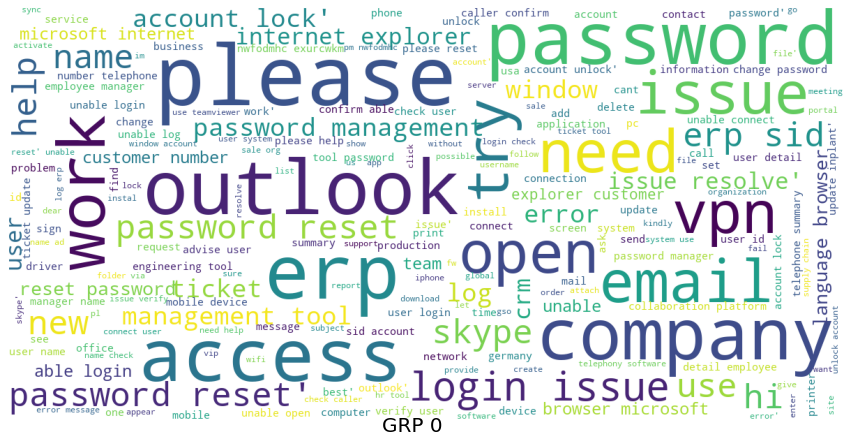

In [48]:
# Word Cloud for Grp 0
Grp0 = resampled_DF[resampled_DF ['Assignment group'] == "GRP_0"]
text_Str = Grp0['combined_sentence'].tolist()
show_wordcloud(text_Str,"GRP 0")

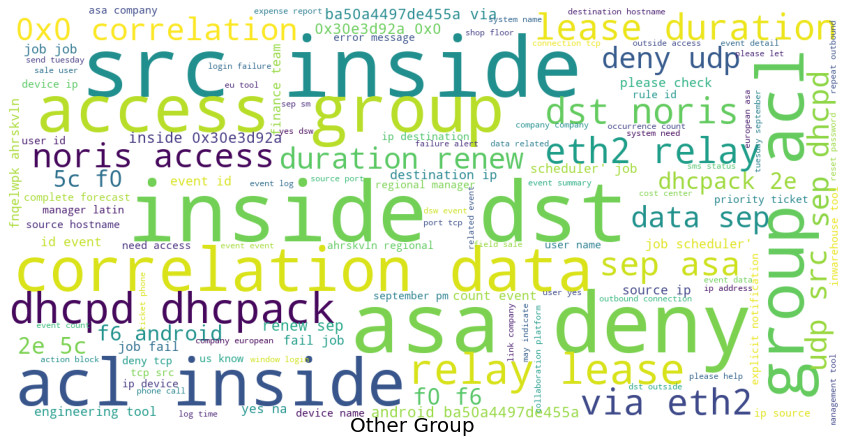

In [49]:
# Word Cloud for non Grp 0
NonGrp0 = resampled_DF[resampled_DF ['Assignment group'] != "GRP_0"]
text_Str = NonGrp0['combined_sentence'].tolist()
show_wordcloud(text_Str,"Other Group")

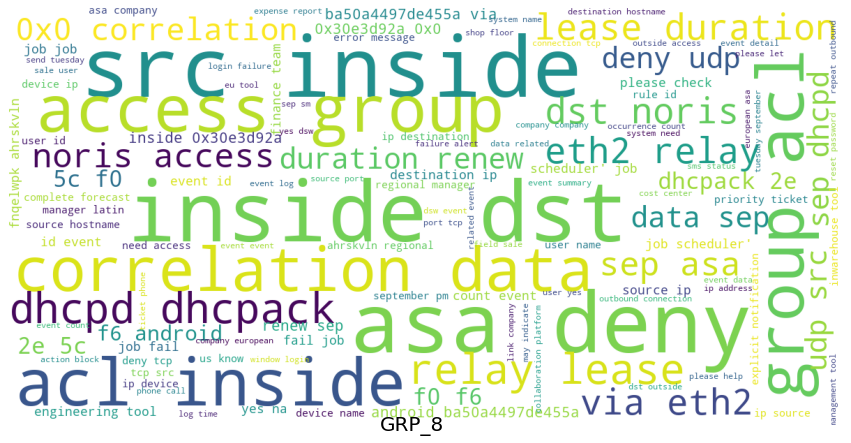

In [50]:
# Word Cloud for non GRP_8
GRP_8 = resampled_DF[resampled_DF ['Assignment group'] == "GRP_8"]
text_Str = NonGrp0['combined_sentence'].tolist()
show_wordcloud(text_Str,"GRP_8")

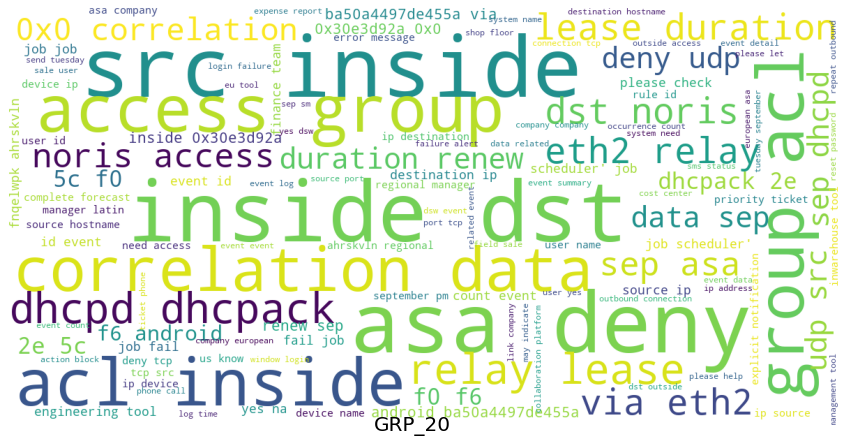

In [51]:
# Word Cloud for non GRP_20
GRP_20 = resampled_DF[resampled_DF ['Assignment group'] == "GRP_20"]
text_Str = NonGrp0['combined_sentence'].tolist()
show_wordcloud(text_Str,"GRP_20")

## BiGram & TriGram visualization

In [52]:
from sklearn.feature_extraction.text import CountVectorizer
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [ ]:
#Top 20 Words
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer(stop_words = 'english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_words(resampled_DF['combined_sentence'], 20)
#for word, freq in common_words:
    #print(word, freq)
df2 = pd.DataFrame(common_words, columns = ['combined_sentence' , 'count'])
df2.groupby('combined_sentence').sum()['count'].sort_values(ascending=False).plot.barh(color='blue', width=.9, figsize=(12, 8))
plt.title('Top 20')
plt.ylabel('Top 20 Words')
plt.xlabel('# of Occurances')
# filename = PROJECT_PATH + "WordCloud Image/"
# plt.savefig(f"{filename}/top20_words.png")

Text(0.5, 0, '# of Occurances')

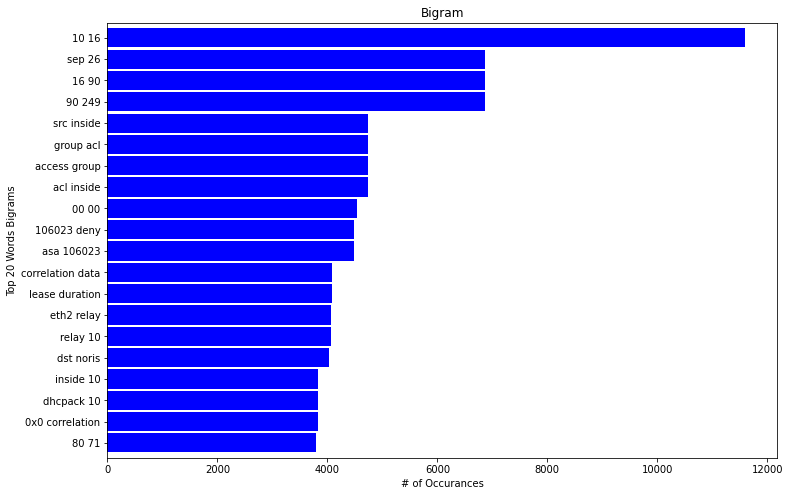

In [53]:
# Plot for Top 20 bigrams
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_bigram(resampled_DF['combined_sentence'], 20)
#for word, freq in common_words:
    #print(word, freq)
df4 = pd.DataFrame(common_words, columns = ['combined_sentence' , 'count'])
df4.groupby('combined_sentence').sum()['count'].sort_values(ascending=True).plot.barh(color='blue', width=.9, figsize=(12, 8))
plt.title('Bigram')
plt.ylabel('Top 20 Words Bigrams')
plt.xlabel('# of Occurances')
# filename = PROJECT_PATH + "WordCloud Image/"
# plt.savefig(f"{filename}/bigrams_top20_words.png")

Text(0.5, 0, '# of Occurances')

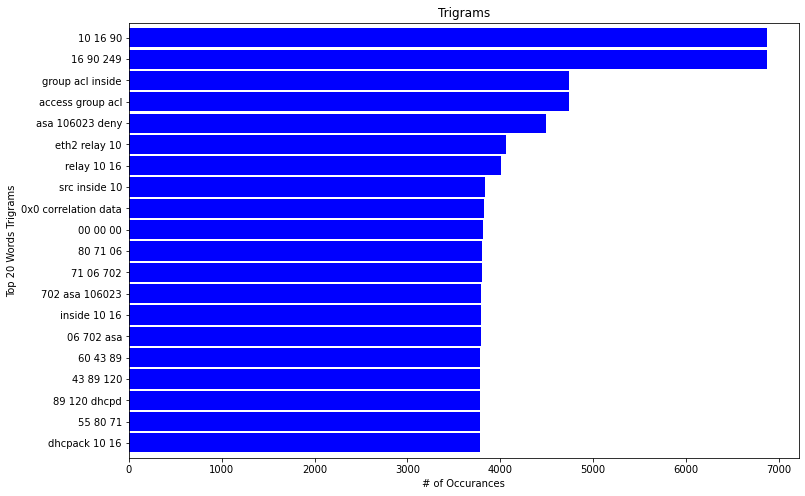

In [54]:
#plot for Top 20 trigrams
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]
common_words = get_top_n_trigram(resampled_DF['combined_sentence'], 20)
#for word, freq in common_words:
    #print(word, freq)
df6 = pd.DataFrame(common_words, columns = ['combined_sentence' , 'count'])
df6.groupby('combined_sentence').sum()['count'].sort_values(ascending=True).plot.barh(color='blue', width=.9, figsize=(12, 8))
plt.title('Trigrams')
plt.ylabel('Top 20 Words Trigrams')
plt.xlabel('# of Occurances')

## Word Embedding Visualization

In [55]:
def build_corpus(df):
    "Creates a list of lists containing words from each sentence"
    corpus = []
    #for col in ['question1', 'question2']:
    for sentence in df['combined_sentence'].iteritems():
      word_list = sentence[1].split(" ")
      corpus.append(word_list)
            
    return corpus

corpus = build_corpus(resampled_DF)        
corpus[0:2]

[['vpn',
  'connection',
  'issue',
  'connect',
  'user',
  'system',
  'use',
  'teamviewer',
  'instal',
  'company',
  'vpn',
  'driver',
  'caller',
  'confirm',
  'able',
  'login',
  'issue',
  'resolve'],
 ['please',
  'access',
  'consultant',
  'vmhfteqo',
  'jpsfikow',
  'schneider',
  'need',
  'wireless',
  'account',
  'extend',
  'end',
  'year',
  'due',
  'expire',
  'per',
  'ticket']]

In [56]:
from gensim.models import word2vec
from sklearn.manifold import TSNE


model = word2vec.Word2Vec(corpus, size=100, window=20, min_count=200, workers=4)
model.wv.most_similar('job')

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('db', 0.6632517576217651),
 ('abended', 0.626032829284668),
 ('engg', 0.5942133665084839),
 ('restart', 0.5789670944213867),
 ('processor', 0.5529080629348755),
 ('qeue', 0.5221744775772095),
 ('fail', 0.5122203826904297),
 ('dba', 0.5113681554794312),
 ('stop', 0.5063010454177856),
 ('imwveudk', 0.47749966382980347)]

In [57]:
def tsne_plot(model):
    "Creates and TSNE model and plots it"
    labels = []
    tokens = []

    for word in model.wv.vocab:
        tokens.append(model[word])
        labels.append(word)
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(20, 10)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()
   
    # plt.savefig(filename)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: DeprecationWarning:

Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).



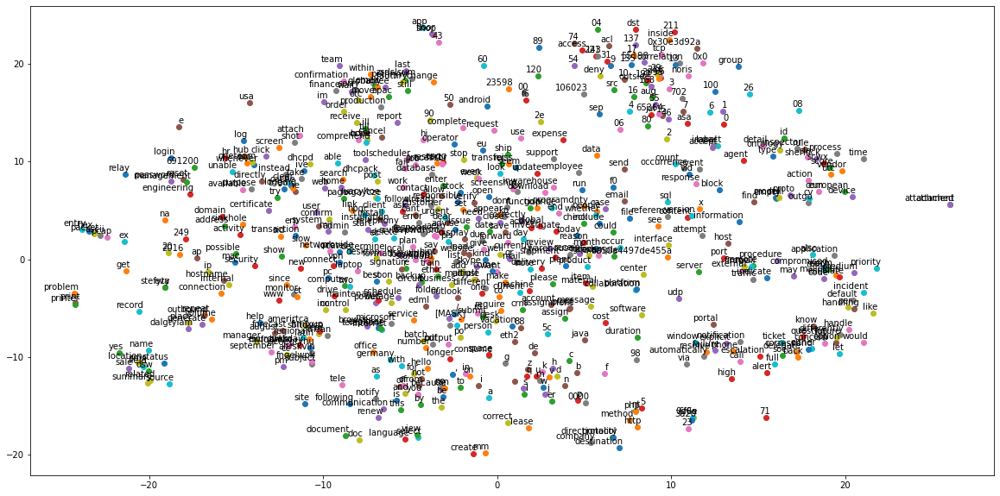

In [58]:
model = word2vec.Word2Vec(corpus, size=100, window=20, min_count=500, workers=4)
tsne_plot(model)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: DeprecationWarning:

Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).



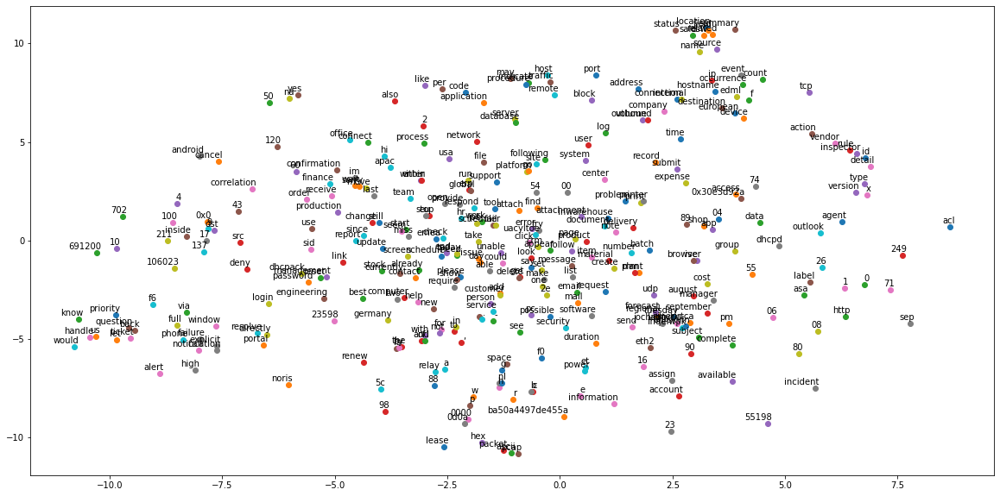

In [59]:
model = word2vec.Word2Vec(corpus, size=100, window=20, min_count=1000, workers=4)
tsne_plot(model)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: DeprecationWarning:

Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).



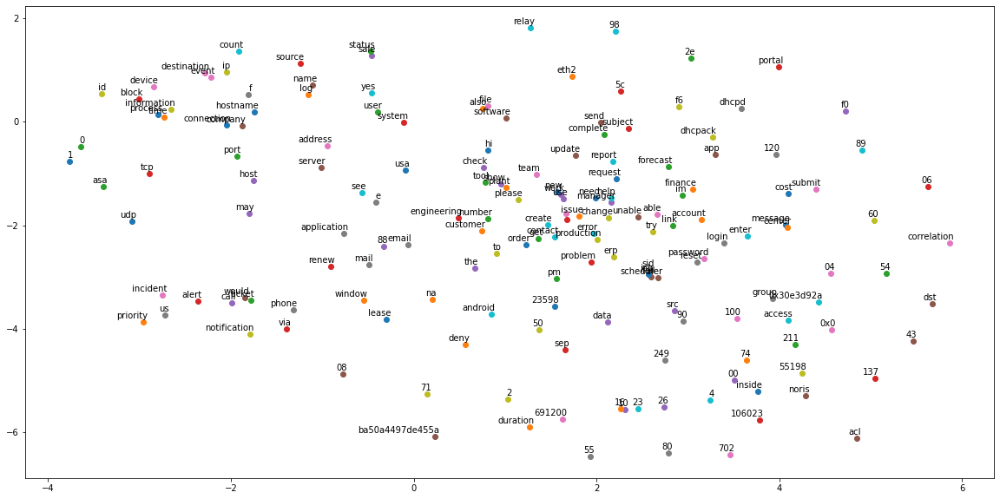

In [60]:
model = word2vec.Word2Vec(corpus, size=100, window=20, min_count=2000, workers=4)
tsne_plot(model)

# **Model**

In [61]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, chi2

from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import accuracy_score

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.layers import Dense, Input, Embedding, Dropout, Activation, Flatten, Bidirectional, GlobalMaxPool1D, LSTM
from keras.models import Model, Sequential

%load_ext tensorboard

## Lable Encode Target Col

In [62]:
from sklearn import preprocessing
le = preprocessing.LabelEncoder()
le.fit(resampled_DF['Assignment group'])
resampled_DF['Target'] = le.transform(resampled_DF['Assignment group'])
resampled_DF.head()

,combined_sentence,Assignment group,Target
7589,vpn connection issue connect user system use t...,GRP_0,0
7324,please access consultant vmhfteqo jpsfikow sch...,GRP_0,0
7358,sep encryption set,GRP_0,0
2791,need check payslip,GRP_0,0
2329,ticket update inplant,GRP_0,0


## Model 1: Tf-IFD vector with Multinomial Naive Bayes

In [63]:
X_train, X_test, y_train, y_test = train_test_split(
    resampled_DF['combined_sentence'].values, resampled_DF['Target'].values, 
    test_size=0.2, random_state=0)
print('Training utterances: {}'.format(X_train.shape[0]))
print('Validation utterances: {}'.format(X_test.shape[0]))

Training utterances: 39131
Validation utterances: 9783


In [64]:
vectorizer = TfidfVectorizer()
vectorizer.fit(X_train)

TfidfVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.float64'>, encoding='utf-8',
                input='content', lowercase=True, max_df=1.0, max_features=None,
                min_df=1, ngram_range=(1, 1), norm='l2', preprocessor=None,
                smooth_idf=True, stop_words=None, strip_accents=None,
                sublinear_tf=False, token_pattern='(?u)\\b\\w\\w+\\b',
                tokenizer=None, use_idf=True, vocabulary=None)

In [65]:
X_train = vectorizer.transform(X_train)
X_test = vectorizer.transform(X_test)
X_train, X_test

(<39131x14212 sparse matrix of type '<class 'numpy.float64'>'
 	with 824215 stored elements in Compressed Sparse Row format>,
 <9783x14212 sparse matrix of type '<class 'numpy.float64'>'
 	with 206739 stored elements in Compressed Sparse Row format>)

In [66]:
ch2 = SelectKBest(chi2, k=5000)
X_train = ch2.fit_transform(X_train, y_train)
X_test = ch2.transform(X_test)

X_train, X_test

(<39131x5000 sparse matrix of type '<class 'numpy.float64'>'
 	with 739161 stored elements in Compressed Sparse Row format>,
 <9783x5000 sparse matrix of type '<class 'numpy.float64'>'
 	with 185341 stored elements in Compressed Sparse Row format>)

In [67]:
clf = MultinomialNB()
clf.fit(X_train, y_train)
pred_train = clf.predict(X_train)
pred_test = clf.predict(X_test)
print(accuracy_score(y_train, pred_train))
print(accuracy_score(y_test, pred_test))

0.8912115713884132
0.8820402739445977


## Import Glove

In [68]:
glove_file = "glove.6B.zip"
#Extract Glove embedding zip file
from zipfile import ZipFile
with ZipFile(glove_file, 'r') as z:
  z.extractall()

In [69]:
EMBEDDING_FILE = './glove.6B.300d.txt'
embeddings = {}
for o in open(EMBEDDING_FILE):
    word = o.split(" ")[0]
    embd = o.split(" ")[1:]
    embd = np.asarray(embd, dtype='float32')
    embeddings[word] = embd

## Model 2: Glove Embedding with Bernoulli Naive Bayes

In [70]:
from nltk.tokenize import RegexpTokenizer
def description_to_words(comp):  
    words = RegexpTokenizer('\w+').tokenize(comp)
    words = list(filter(lambda a: a != '', words))  
    return words

In [71]:
#Taking average of all word embeddings in a sentence to generate the sentence representation.
data_list = list()
for comp in resampled_DF['combined_sentence']:
    sentence = np.zeros(300)
    count = 0
    for w in description_to_words(comp):
        try:
            sentence += embeddings[w]
            count += 1.0
        except KeyError:
            continue
    data_list.append(sentence)

In [75]:
X_train, X_test, y_train, y_test = train_test_split(np.array(data_list), resampled_DF.Target.values, 
    test_size=0.2, random_state=0)

In [76]:
print(X_train.shape)
print(y_train.shape)

(39131, 300)
(39131,)


In [77]:
clf = BernoulliNB()
clf.fit(X_train, y_train)
pred_train = clf.predict(X_train)
pred_test = clf.predict(X_test)
print(accuracy_score(y_train, pred_train))
print(accuracy_score(y_test, pred_test))

0.6391863228642253
0.6339568639476643


## Model 3: Glove embedding with simple LSTM model

In [78]:
all_words = list()
for comp in resampled_DF['combined_sentence']:
    for w in comp.split(" "):
        all_words.append(w)

In [79]:
vocab = len(all_words)
print(vocab)

1642876


In [80]:
max_features = 12000
maxlen = 300
embedding_size = 300

In [81]:
tokenizer = Tokenizer(num_words=max_features)
tokenizer.fit_on_texts(list(resampled_DF['combined_sentence']))

In [82]:
X = tokenizer.texts_to_sequences(resampled_DF['combined_sentence'])
X = pad_sequences(X, maxlen = maxlen)

from keras.utils import to_categorical
y = to_categorical(resampled_DF['Target'])

print("Number of Samples:", len(X))
print(X[0])
print("Number of Labels: ", len(y))
print(y[0])

Number of Samples: 48914
[   0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0    0    0    0    0
    0    0    0    0    0    0    0    0    0    0  

In [83]:
vocab = tokenizer.word_index
vocab_size = len(vocab)
vocab_size

14583

In [84]:
all_embs = np.stack(embeddings.values())
emb_mean,emb_std = all_embs.mean(), all_embs.std()
embed_size = all_embs.shape[1]

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2822: FutureWarning:

arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.



In [85]:
nb_words = min(max_features, len(vocab))+1
embedding_matrix = np.random.normal(emb_mean, emb_std, (nb_words, embedding_size))
for word, i in tokenizer.word_index.items():
    if i >= max_features: continue
    embedding_vector = embeddings.get(word)
    if embedding_vector is not None: embedding_matrix[i] = embedding_vector

In [86]:
embedding_matrix

array([[ 0.57828566, -0.0458486 , -0.21290764, ..., -0.11697962,
         0.04151183,  0.61319487],
       [-0.049169  , -0.30989999, -0.40156999, ..., -0.47082001,
         0.31920001,  0.0268    ],
       [-0.44189   ,  0.24247999, -0.22996999, ..., -0.77638   ,
        -0.054478  , -0.13019   ],
       ...,
       [-0.044975  , -0.38301   , -0.19541   , ..., -0.61189997,
        -0.072234  ,  0.156     ],
       [ 0.18476   , -0.05483   , -0.15554   , ..., -0.22105999,
         0.34437999, -0.084158  ],
       [-0.05820016, -1.08777324, -0.29682052, ...,  0.63840476,
         0.21771866, -0.18057826]])

In [87]:
#Build LSTM Model
model = Sequential()
model.add(Embedding(nb_words, embedding_size, weights = [embedding_matrix]))
model.add((LSTM(200, return_sequences = True)))
model.add(GlobalMaxPool1D())
model.add(Dense(74, activation="softmax"))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy','AUC'])

In [88]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 300)         3600300   
_________________________________________________________________
lstm (LSTM)                  (None, None, 200)         400800    
_________________________________________________________________
global_max_pooling1d (Global (None, 200)               0         
_________________________________________________________________
dense (Dense)                (None, 74)                14874     
Total params: 4,015,974
Trainable params: 4,015,974
Non-trainable params: 0
_________________________________________________________________


In [89]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2 , random_state = 1) 
x_train.shape

(39131, 300)

In [90]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard
my_callbacks = [
    EarlyStopping(monitor="val_loss", patience=10, mode="auto"),
    ModelCheckpoint("model-{val_loss:.2f}.h5", monitor="val_loss", verbose=1, save_best_only=True, save_weights_only=True, mode="auto", period=1),
    TensorBoard(log_dir='./logs'),
]

In [91]:
batch_size = 500
epochs = 200
history = model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_data = (x_test,y_test),callbacks= my_callbacks)

Epoch 1/200
 1/79 [..............................] - ETA: 0s - loss: 4.3199 - accuracy: 0.0120 - auc: 0.5073WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
79/79 [==============================] - ETA: 0s - loss: 2.7126 - accuracy: 0.4664 - auc: 0.9031
Epoch 00001: val_loss improved from inf to 1.40803, saving model to model-1.41.h5
79/79 [==============================] - 24s 299ms/step - loss: 2.7126 - accuracy: 0.4664 - auc: 0.9031 - val_loss: 1.4080 - val_accuracy: 0.6844 - val_auc: 0.9812
Epoch 2/200
79/79 [==============================] - ETA: 0s - loss: 0.9317 - accuracy: 0.7947 - auc: 0.9919
Epoch 00002: val_loss improved from 1.40803 to 0.69131, saving model to model-0.69.h5
79/79 [==============================] - 22s 281ms/step - loss: 0.9317 - acc

In [92]:
print("Accuracy of the model on Training Data is - " , model.evaluate(x_train,y_train)[1]*100)
print("Accuracy of the model on Testing Data is - " , model.evaluate(x_test,y_test)[1]*100)

1223/1223 [==============================] - 15s 12ms/step - loss: 0.0853 - accuracy: 0.9690 - auc: 0.9998
Accuracy of the model on Training Data is -  96.90271019935608
306/306 [==============================] - 4s 12ms/step - loss: 0.1574 - accuracy: 0.9532 - auc: 0.9975
Accuracy of the model on Testing Data is -  95.31840682029724


In [93]:
%tensorboard --logdir ./logs

Output hidden; open in https://colab.research.google.com to view.

In [94]:
def PlotModelPerformence(history):
  fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15,5))
  fig.suptitle("Performance of Glove Vectors")
  ax1.plot(history.history['accuracy'])
  ax1.plot(history.history['val_accuracy'])
  vline_cut = np.where(history.history['val_accuracy'] == np.max(history.history['val_accuracy']))[0][0]
  ax1.axvline(x=vline_cut, color='k', linestyle='--')
  ax1.set_title("Model Accuracy")
  ax1.legend(['train', 'val'])

  ax2.plot(history.history['loss'])
  ax2.plot(history.history['val_loss'])
  vline_cut = np.where(history.history['val_loss'] == np.min(history.history['val_loss']))[0][0]
  ax2.axvline(x=vline_cut, color='k', linestyle='--')
  ax2.set_title("Model Loss")
  ax2.legend(['train', 'val'])
  plt.show()


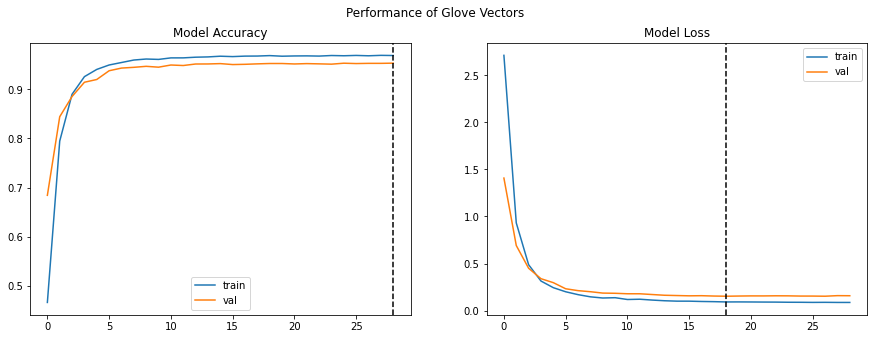

In [95]:
PlotModelPerformence(history)

## Model 4: Golve Embedding with Bidirection LSTM

In [96]:
#Build Model Bidirectional LSTM
model = Sequential()
model.add(Embedding(nb_words, embedding_size, weights = [embedding_matrix]))
model.add(Bidirectional(LSTM(240, return_sequences = True)))
model.add(GlobalMaxPool1D())
model.add(Dense(74, activation="softmax"))
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy','AUC'])

In [97]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding_1 (Embedding)      (None, None, 300)         3600300   
_________________________________________________________________
bidirectional (Bidirectional (None, None, 480)         1038720   
_________________________________________________________________
global_max_pooling1d_1 (Glob (None, 480)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 74)                35594     
Total params: 4,674,614
Trainable params: 4,674,614
Non-trainable params: 0
_________________________________________________________________


In [98]:
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size = 0.2 , random_state = 1) 

In [99]:
batch_size = 500
epochs = 200
history = model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, validation_data = (x_test,y_test),callbacks= my_callbacks)

Epoch 1/200
79/79 [==============================] - ETA: 0s - loss: 2.2581 - accuracy: 0.5416 - auc: 0.9369
Epoch 00001: val_loss did not improve from 0.15211
79/79 [==============================] - 42s 532ms/step - loss: 2.2581 - accuracy: 0.5416 - auc: 0.9369 - val_loss: 0.9917 - val_accuracy: 0.7696 - val_auc: 0.9908
Epoch 2/200
79/79 [==============================] - ETA: 0s - loss: 0.6438 - accuracy: 0.8530 - auc: 0.9958
Epoch 00002: val_loss did not improve from 0.15211
79/79 [==============================] - 42s 527ms/step - loss: 0.6438 - accuracy: 0.8530 - auc: 0.9958 - val_loss: 0.4948 - val_accuracy: 0.8840 - val_auc: 0.9964
Epoch 3/200
79/79 [==============================] - ETA: 0s - loss: 0.3379 - accuracy: 0.9195 - auc: 0.9984
Epoch 00003: val_loss did not improve from 0.15211
79/79 [==============================] - 42s 533ms/step - loss: 0.3379 - accuracy: 0.9195 - auc: 0.9984 - val_loss: 0.3165 - val_accuracy: 0.9175 - val_auc: 0.9979
Epoch 4/200
79/79 [=========

In [100]:
print("Accuracy of the model on Training Data is - " , model.evaluate(x_train,y_train)[1]*100)
print("Accuracy of the model on Testing Data is - " , model.evaluate(x_test,y_test)[1]*100)

1223/1223 [==============================] - 26s 21ms/step - loss: 0.0823 - accuracy: 0.9691 - auc: 0.9997
Accuracy of the model on Training Data is -  96.91293239593506
306/306 [==============================] - 6s 21ms/step - loss: 0.1512 - accuracy: 0.9546 - auc: 0.9976
Accuracy of the model on Testing Data is -  95.46151757240295


In [101]:
%tensorboard --logdir ./logs

Output hidden; open in https://colab.research.google.com to view.

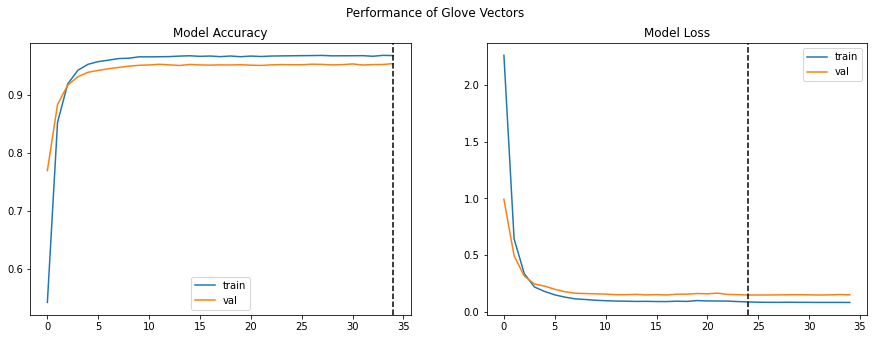

In [102]:
PlotModelPerformence(history)

# **Summary**

In [103]:
from prettytable import PrettyTable

In [104]:
x = PrettyTable()
x.field_names = ["Algorithm","Accuracy"]
x.add_row(["Multinomail NB","88.51"])
x.add_row(["Bernoli NB","61.67"])
x.add_row(["LSTM","95.96"])
x.add_row(["Bidirectional LSTM","95.56"])
print(x)

+--------------------+----------+
|     Algorithm      | Accuracy |
+--------------------+----------+
|   Multinomail NB   |  88.51   |
|     Bernoli NB     |  61.67   |
|        LSTM        |  95.96   |
| Bidirectional LSTM |  95.56   |
+--------------------+----------+


We can see that LSTM and BiDirectional LSTM both gives almost the same accuracy. So we would like to go with Bidirectional LSTM as it gives better accurcay when trained with raw data.

Our objective was to predict the ticket with alteast 85% accuracy. With our trained model predicted accuracy we can say that we beat our objective with 95% accuracy.

# **Limitation** and **Future Improvemets**

As the data is biased towards Grp 0 and Lots of Grp has very less number of ticket. So it's very hard for a model to predict those groups. We augument and resample the data set to make the model works.
In future if we can collect more and more data of different groups that will help the model to predict more accurately.

We also found that data is multiple language which create variablity. It will good for bussiness if there will be some unified portal for ticket generation which gives more relateable data.
